**CURSO**: Análisis Geoespacial, Departamento de Geociencias y Medio Ambiente, Universidad Nacional de Colombia - sede Medellín <br/>
**Profesor**: Edier Aristizábal (evaristizabalg@unal.edu.co) <br />
**Classroom code**: [32cjlau] <br />
**Credits**: The content of this notebook is taken from several sources: [Patrik Mahadik](https://pratik-mahadik5.medium.com/osmnx-handling-street-networks-6d8a8cbb0628s). Every effort has been made to trace copyright holders of the materials used in this book. The author apologies for any unintentional omissions and would be pleased to add an acknowledgment in future editions. 

# Networks

Started in year 2005 Google Maps has been the top service provider for location based services. Google Maps has many rich features including satellite imagery, topographic data to 3D and street view images. Its routing and live traffic features help individuals to business for taking better decision and make optimal schedules.

In [1]:
from IPython.display import Image
Image(url="https://miro.medium.com/max/600/1*B1EBC7tMLYzT9-pghGyLKw.png")

Google Maps API can be used in websites to show location and features as well as are used by many application for routing purposes. Example, Food Delivery Company as Swiggy, Zomato, etc. use Google Maps Routing API for their routing applications to efficiently deliver food in less time. But this power comes at a cost. Google Maps API is a proprietary software from Google and is very costly use. It costs around 0–10 USD per 1000 query made.

OSM (Open Street Maps) is a community driven map service provider is open source i.e. free for use. Each individual in the community helps to gather data and feed it to the OSM Map Server. Even Google Maps takes data from OSM to use in there Map Services. Daily the data is being updated by crowd sourcing and made freely available to billions of people.

Here are some API and library which uses the OSM street network data for routing and other services as follows:

* OSMnx (Python)
* GraphHopper (JAVA)
* PyrouteLib (Python)
* Openrouteservice (JAVA)
* SimpleOsmRouter (Python)

## OSMnx

[OSMnx](https://osmnx.readthedocs.io/en/stable/osmnx.html) which is a python library which can be used to analyze street network data for purpose based on graph theory. It uses networkx library which is a python library for studying graphs and networks. OSMnx lets you download road data in form of nodes and edges. This data is retrieved from OSM street networks which can be then modeled and visualized. Let’s start with installing the library and importing them.

In [2]:
import osmnx as ox

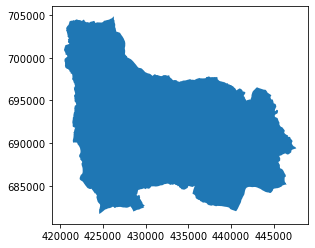

In [3]:
city = ox.geocode_to_gdf('Medellín, Colombia')
ax = ox.project_gdf(city).plot()

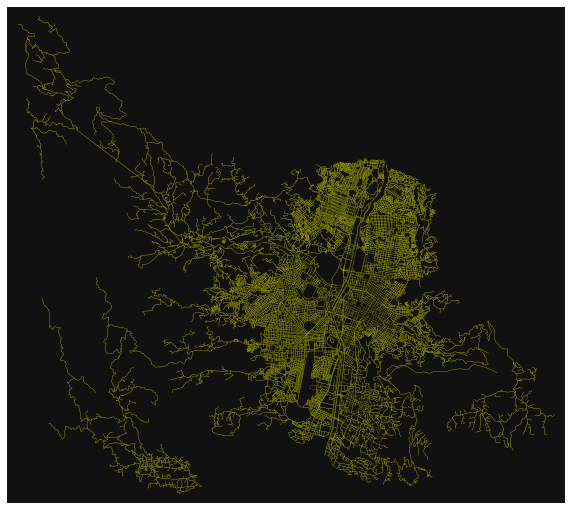

(<Figure size 720x720 with 1 Axes>, <AxesSubplot:>)

In [4]:
G = ox.graph_from_place('Medellín, Colombia', network_type='drive')
ox.plot_graph(G, figsize=(10, 10), node_size=0, edge_color='y', edge_linewidth=0.2)

Create new dataframe to collect street networks within each voronoi regions

In [5]:
# get all the parks in some neighborhood
# constrain acceptable `leisure` tag values to `park`
place = 'Medellín, Colombia'
tags = {'leisure': 'park'}
gdf = ox.geometries_from_place(place, tags)
gdf.head()

,unique_id,osmid,element_type,geometry,name,leisure,description,name:en,tourism,wikidata,...,denomination,surface,opening_hours:covid19,access,dog,note,addr:postcode,ways,fixme,type
0,node/3698821056,3698821056,node,POINT (-75.59766 6.21591),Canalización La Mota,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/3748104496,3748104496,node,POINT (-75.53658 6.29701),parque,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node/3799873281,3799873281,node,POINT (-75.53896 6.29658),NaN,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,node/4177117294,4177117294,node,POINT (-75.54455 6.29402),DE PAN,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,node/4177131411,4177131411,node,POINT (-75.54495 6.29082),Parque De La Cancha,park,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# get everything tagged amenity,
# and everything tagged landuse = retail or commercial,
# and everything tagged highway = bus_stop
tags = {'amenity' : True,
        'landuse' : ['retail', 'commercial'],
        'highway' : 'bus_stop'}
gdf = ox.geometries_from_place('Medellín, Colombia', tags)
gdf.shape

/opt/conda/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


(4186, 229)

In [7]:
# view just the banks
gdf[gdf['amenity']=='bank'].dropna(axis=1, how='any')

/opt/conda/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,unique_id,osmid,element_type,amenity,geometry
3,node/338172348,338172348,node,bank,POINT (-75.57888 6.18369)
139,node/1301957616,1301957616,node,bank,POINT (-75.57338 6.24506)
199,node/1656789265,1656789265,node,bank,POINT (-75.57246 6.20187)
201,node/1657087256,1657087256,node,bank,POINT (-75.57177 6.20652)
205,node/1661049493,1661049493,node,bank,POINT (-75.57395 6.19703)
...,...,...,...,...,...
3591,way/576893946,576893946,way,bank,"POLYGON ((-75.56390 6.25020, -75.56381 6.25037..."
3602,way/578911169,578911169,way,bank,"POLYGON ((-75.57308 6.24206, -75.57301 6.24223..."
3603,way/579013177,579013177,way,bank,"POLYGON ((-75.57333 6.24935, -75.57329 6.24945..."
3617,way/579440533,579440533,way,bank,"POLYGON ((-75.55390 6.30649, -75.55385 6.30648..."


/opt/conda/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


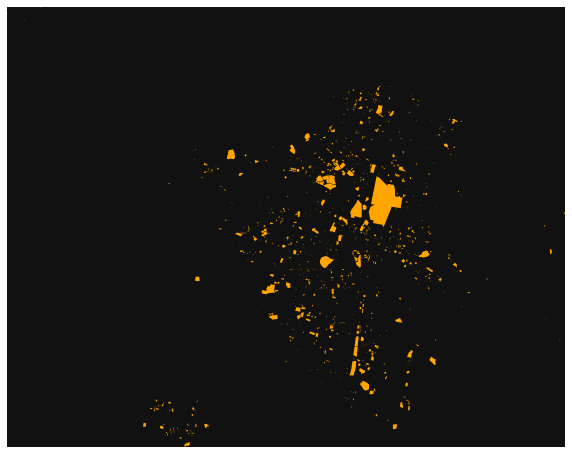

In [8]:
fig, ax = ox.plot_footprints(gdf, figsize=(10, 10))

In [9]:
import geopandas as gpd 
import networkx as nx 
import numpy as np
import matplotlib.pyplot as plt

In [28]:
location = (6.2159,-75.5976) 
mode = "drive"  #Transportation mode
ox.config(log_console=True, use_cache=True)

We will start with fetching data using latitude and longitude coordinates. We can fetch data of different transportation modes such as ‘walk’, ‘bike’, ‘drive’, ‘drive_service’, ‘all’, or ‘all_private’.

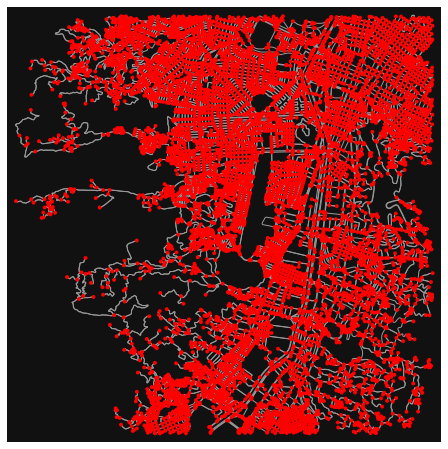

(<Figure size 576x576 with 1 Axes>, <AxesSubplot:>)

In [29]:
G = ox.graph_from_point(location, dist=5000, simplify=True, network_type=mode) 
nodes_proj, edges_proj = ox.graph_to_gdfs(G, nodes=True, edges=True)
ox.plot_graph(G,node_color='r')

Using graph_from_point function street network data is retrieved in the form of nodes and edges. Nodes being junction or intersection and edges are lines (roads) connecting two nodes. You can specify distance from the coordinate given to fetch data for. Also to return simplified geometry you keep simplify as True. The plot_graph function will plot the street network and the nodes can be colourized using node_color parameter.

### Finding shortest Path

Now we will move forward to finding shortest path from one point to another point. First define origin point and destination point then find the nearest node from the graph. Then use the shortest_path function to find shortest route. But this function will only give one shortest route. To get more optiomal path use k_shortest_path function where parameter k denotes number of optimal roads required and you can state any column name to be used for weighing function.

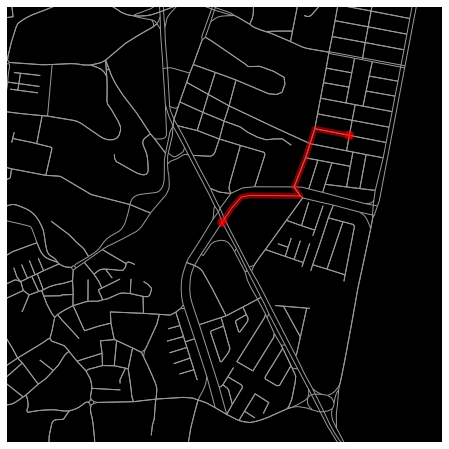

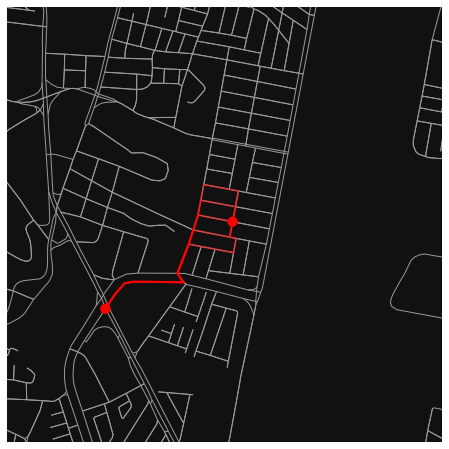

In [30]:
origin_point = (6.2159,-75.5976) 
destination_point =(6.2184,-75.5942)

# get the nearest nodes to the locations 
origin_node = ox.get_nearest_node(G, origin_point) 
destination_node = ox.get_nearest_node(G, destination_point) 

route = ox.shortest_path(G, origin_node,destination_node) 
bbox = ox.utils_geo.bbox_from_point(point=(6.2159,-75.5976), dist=700) 
fig, ax = ox.plot_graph_route(G, route, bbox = bbox, route_linewidth=6, node_size=0, bgcolor='k') 

routes = ox.k_shortest_paths(G, origin_node, destination_node, k=5, weight='length') 
bbox = ox.utils_geo.bbox_from_point(point=(6.2184,-75.5942), dist=700) 
fig, ax = ox.plot_graph_routes(G, list(routes), bbox = bbox, route_colors='r', route_linewidth=2, node_size=0)

### Create Isochrones

/opt/conda/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


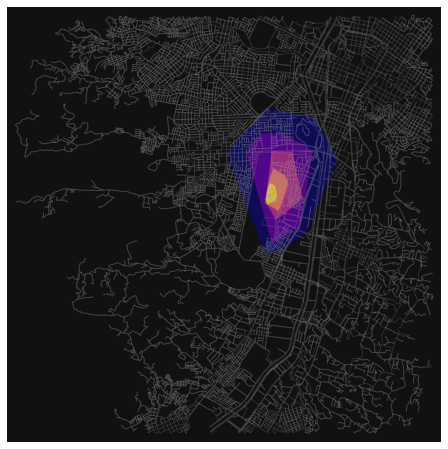

In [37]:
from shapely.geometry import Point, LineString, Polygon
from descartes import PolygonPatch

# configure the trip times, and travel speed
trip_times = [5, 10, 15, 20, 25] #in minutes
travel_speed = 4.5 #walking speed in km/hour
gdf_nodes = ox.graph_to_gdfs(G, edges=False)
x, y = gdf_nodes['geometry'].unary_union.centroid.xy
center_node = ox.get_nearest_node(G, (y[0], x[0]))

# get one color for each isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), cmap='plasma', start=0, return_hex=True)

# make the isochrone polygons
isochrone_polys = []
for trip_time in sorted(trip_times, reverse=True):
    subgraph = nx.ego_graph(G, center_node, radius=trip_time, distance='time')
    node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
    bounding_poly = gpd.GeoSeries(node_points).unary_union.convex_hull
    isochrone_polys.append(bounding_poly)

# plot the network then add isochrones as colored descartes polygon patches
fig, ax = ox.plot_graph(G, show=False, close=False, edge_color='#999999', edge_alpha=0.2, node_size=0)
for polygon, fc in zip(isochrone_polys, iso_colors):
    patch = PolygonPatch(polygon, fc=fc, ec='none', alpha=0.6, zorder=-1)
    ax.add_patch(patch)
plt.show()

### Highlight Oneway Roads

To visualize one way we can use the oneway column from edges. Here we will visualize oneway roads in red and others in white and with plot them.

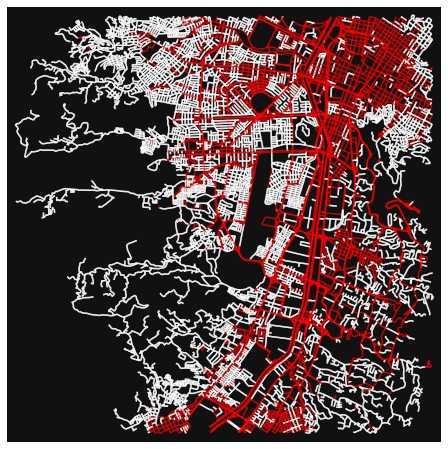

In [31]:
ec = ['r' if data['oneway'] else 'w' for u, v, key, data in G.edges(keys=True, data=True)] 
fig, ax = ox.plot_graph(G, node_size=0, edge_color=ec, edge_linewidth=1.5, edge_alpha=0.7)

### Steet centrality colour gradient

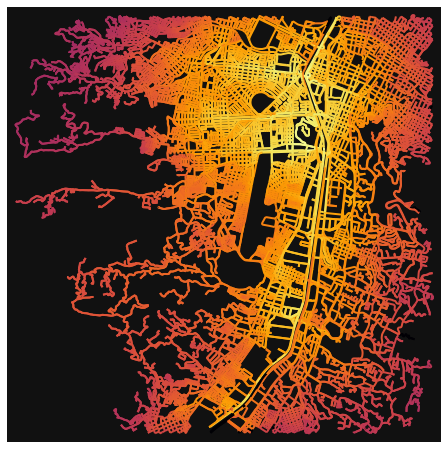

In [38]:
# convert graph to line graph so edges become nodes and vice versa
edge_centrality = nx.closeness_centrality(nx.line_graph(G))
nx.set_edge_attributes(G, edge_centrality, 'edge_centrality')

# color edges in original graph with closeness centralities from line graph
ec = ox.plot.get_edge_colors_by_attr(G, 'edge_centrality', cmap='inferno')
fig, ax = ox.plot_graph(G, edge_color=ec, edge_linewidth=2, node_size=0)

### Plot routes on folium
To plot routes and street networks on folium we should use plot_graph_folium and plot_route_folium function. First we will get any origin and destination nodes from the graph object retrieved from OSM server. Then we will find shortest route between them. While creating graph and route on folium we can specify which column values to be used for popup. We can save this web map as an html page for sharing.

In [33]:
origin_node = list(G.nodes())[0] 
destination_node = list(G.nodes())[-1] 
route = nx.shortest_path(G, origin_node, destination_node) 
graph_map = ox.plot_graph_folium(G, popup_attribute='name', edge_width=2) 
route_graph_map = ox.plot_route_folium(G, route, route_map=graph_map, popup_attribute='length') 
route_graph_map.save('route.html') 
route_graph_map

### Saving network data to disk
Downloaded street network data can be saved in various format such as geopackage or shp format for using it with GIS softwares. And also can be saved as an svg image or as a graphml file.

In [34]:
ox.save_graph_geopackage(G, filepath='./data/street_network.gpkg') 
ox.save_graphml(G, filepath='./data/street_network.graphml') 
ox.save_graph_shapefile(G, filepath='./data/streets') 
ox.plot_graph(G, show=False, save=True, close=True, filepath='./images/street_network.svg')
ox.save_graph_xml(G, filepath='./data/street_network.osm')

/opt/conda/lib/python3.8/site-packages/osmnx/osm_xml.py:181: UserWarning: In order for save_graph_xml to behave properly the graph must have been created with the `all_oneway` setting set to True.
  warnings.warn(msg)
